# 8. Gyakorlat: Objektum Detekció
## Könyvtárak

In [1]:
import os
import cv2
import warnings
import requests
import numpy as np
import pandas as pd
from PIL import Image
from io import BytesIO
import matplotlib as mpl
from zipfile import ZipFile
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
from pycocotools.coco import COCO
import matplotlib.patches as patches

import torch
from torchvision import datasets
from torchvision import transforms
from torchvision.ops import box_iou
from torchvision.models import detection
from torch.utils.data import DataLoader, Dataset
from torch.utils.data._utils.collate import default_collate
from torchvision.models.detection import MaskRCNN_ResNet50_FPN_Weights

warnings.filterwarnings('ignore')
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

## Adathalmaz
### Letöltés

In [2]:
url = 'https://github.com/ultralytics/yolov5/releases/download/v1.0/coco128.zip'  # Link az adatokhoz
response = requests.get(url)  # HTTP kérés intézése 

if response.status_code == 200:
    zip_content = BytesIO(response.content)  # Adatok letöltése
    with ZipFile(zip_content, 'r') as zip_ref:
        zip_ref.extractall(".")
    print("Az adatok letöltése sikeres volt")
else:
    print("Az adatok letöltése sikertelen volt:", response.status_code)

# Címkék betöltése
label_names = pd.read_csv('./coco128/coco_labels.txt', names=['name'])
label_names['color'] = [(np.random.randint(0, 255), np.random.randint(0, 255), np.random.randint(0, 255)) for _ in range(len(label_names))]  # Véletlen szín generálása minden osztályhoz tartozóan
display(label_names.head())

Az adatok letöltése sikeres volt


,name,color
0,person,"(199, 142, 56)"
1,bicycle,"(137, 227, 134)"
2,car,"(107, 112, 79)"
3,motorcycle,"(87, 78, 237)"
4,airplane,"(243, 6, 67)"


### Tisztítás

In [3]:
images_dir = './coco128/images/train2017/'
labels_dir = './coco128/labels/train2017/'


def remove_unpaired_datapoints(src_dir, dst_dir):  # Amelyik képhez nem tartozik címke fájl le kell törölni
    for src_name in os.listdir(src_dir):  # Iteráció minden fájlra a forrásmappában 
        src_file = os.path.join(src_dir, src_name)
        src_filename = os.path.splitext(os.path.basename(src_file))[0]
        flag = False
        for dst_name in os.listdir(dst_dir):  # Iteráció minden fájlra a célmappában
            dst_file = os.path.join(dst_dir, dst_name)
            dst_filename = os.path.splitext(os.path.basename(dst_file))[0]
            if dst_filename == src_filename:
                flag = True
        if not flag:
            os.remove(src_file)
            print(f'Removed: {src_file}')


# Meghívás mind a két könyvtárra
remove_unpaired_datapoints(images_dir, labels_dir)
remove_unpaired_datapoints(labels_dir, images_dir)

# Ellenőrzés, hogy tényleg minden képhez tartozik címke
for x, y in list(zip(sorted(os.listdir('./coco128/images/train2017')), sorted(os.listdir('./coco128/labels/train2017')))):
    x = x.split('.')[0]
    y = y.split('.')[0]
    if x != y:
        print(f'Unpaired datapoint: {x}, {y}')

Removed: ./coco128/images/train2017/000000000508.jpg
Removed: ./coco128/images/train2017/000000000250.jpg
Removed: ./coco128/labels/train2017/000000000656.txt
Removed: ./coco128/labels/train2017/000000000659.txt


## Modellek betöltése

In [4]:
# Modellfájlok betöltése
mask = detection.maskrcnn_resnet50_fpn(weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1)
faster = detection.fasterrcnn_mobilenet_v3_large_fpn(pretrained=True, pretrained_backbone=True, progress=True)
retina = detection.retinanet_resnet50_fpn(pretrained=True, pretrained_backbone=True, progress=True)

# Modellek predikciós üzemmódba kapcsolása
mask.eval()
faster.eval()
retina.eval()

# Egy lista, hogy később lehessen iterálni a modelleken
models = [mask, faster, retina]

# Képek normalizálásához értékek
mean = np.array([0.485, 0.456, 0.406])  # Várható érték
std = np.array([0.229, 0.224, 0.225])  # Szórás

## Adatbetöltő létrehozása
### Adathalmaz osztály

In [5]:
class COCO128Dataset(Dataset):
    def __init__(self, root_dir):
        self.root_dir = root_dir
        self.image_size = (256, 256)  # Képméret
        self.images_dir = os.path.join(self.root_dir, 'images/train2017')  # Képek mappája
        self.labels_dir = os.path.join(self.root_dir, 'labels/train2017')  # Címkék mappája
        self.images = sorted(os.listdir(self.images_dir))  # Képek fájlneveinek betöltése
        self.labels = sorted(os.listdir(self.labels_dir))  # Címkék fájlneveinek betöltése
        self.transform = transforms.Compose([  # Transzformáció minden képre
            transforms.Resize(self.image_size),  # Kép átméretezése
            transforms.ToTensor(),  # Képek átalakítása torch tenzorokká
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalizálás
        ])

    def __len__(self):  # Adathalmaz hosszának megadása
        return len(self.images)

    def denormalize_yolo_box(self, box):  # Kép kereteződoboz koordináták képkoordinátákká alakítása
        class_id, x_center, y_center, width, height = box  # Doboz változó kicsomagolása
        img_width, img_height = self.image_size  # Szélesség és magasság
        x1 = int((x_center - width / 2) * img_width)  
        y1 = int((y_center - height / 2) * img_height)
        x2 = int((x_center + width / 2) * img_width)
        y2 = int((y_center + height / 2) * img_height)
        return x1, y1, x2, y2

    def load_labels(self, label_path):  # Címkék betöltése  
        labels = []
        with open(label_path, 'r') as file:  # Fájl megnyitása
            for line in file:  # Iteráció minden soron
                class_id, x_center, y_center, width, height = map(float, line.split())  # Értékek betöltése és lebegőpontos számmá alakítása
                x1, y1, x2, y2 = self.denormalize_yolo_box((class_id, x_center, y_center, width, height))  # Kép kereteződobozok denormalizálása
                labels.append((class_id, x1, y1, x2, y2))  # Hozzáfűzés a teljes címkehalmazhoz
        return labels

    def __getitem__(self, idx):  # Egyetlen elem lekérése az adathalmazból
        image_name = os.path.join(self.images_dir, self.images[idx])  # Kép fájlnév lekérése
        image = Image.open(image_name).convert('RGB')  # Kép megnyitása
        image = self.transform(image)  # Transzformációk alkalmazása a képen
        labels_name = os.path.join(self.labels_dir, self.images[idx].replace('.jpg', '.txt'))  # Címke fájlnév megadása
        labels = self.load_labels(labels_name)  # Címke betöltése 
        return image, labels


# Adatbetöltő létrehozása és kipróblálása
data_dir = './coco128'
coco_dataset = COCO128Dataset(data_dir)

### Adatbetöltő

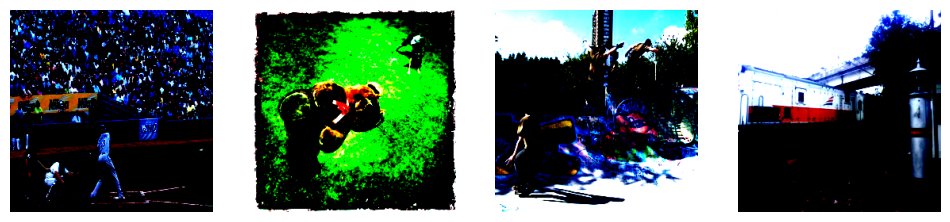

In [6]:
def custom_collate(batch):  # Kollatálás (Minden adatpontnak ugyanakkora dimenzióval kell rendelkeznie, ezért ki kell pótolni ahol rövidebb)
    images = [item[0] for item in batch]  # Képek betöltése egy listába
    labels = [item[1] for item in batch]  # Címkék betöltése egy listába
    images = default_collate(images)
    return images, labels


def plot_images(dataloader):  # Képek kirajzolása
    images, labels = next(iter(dataloader))  # Egy képköteg lekérdezése
    plt.figure(figsize=(12, 8))
    for i, image in enumerate(images):
        image = np.clip(image, 0, 1)
        plt.subplot(1, len(images), i + 1)
        plt.imshow(image.permute(1, 2, 0))  # Dimenziók átrendezése átrendezése BGR -> RGB
        plt.axis('off')
    plt.show()


# Adatbetöltő létrehozása
dataloader = DataLoader(coco_dataset, batch_size=4, shuffle=True, collate_fn=custom_collate)
plot_images(dataloader)

### Kereteződobozok kipróbálása

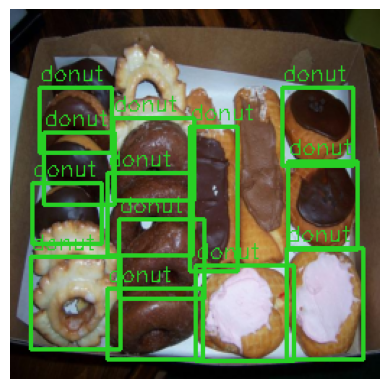

In [7]:
def plot_single_image_with_boxes(image_size):
    # Kép betöltése és transzformálása
    random_idx = np.random.randint(0, len(coco_dataset))  # Véletlen képindex generálása
    image_path = './coco128/images/train2017/' + coco_dataset.images[random_idx]  # Hozzá tartozó kép lekérdezése
    label_path = './coco128/labels/train2017/' + coco_dataset.labels[random_idx]  # Hozzá tartozó címke lekérdezése
    image = Image.open(image_path).convert('RGB')
    image = transforms.Resize(image_size)(image)
    np_image = np.array(image)
    
    # Címkék betöltése
    labels = []
    with open(label_path, 'r') as file:
        for line in file:
            class_id, x_center, y_center, width, height = map(float, line.split())  # Koordináták lebegőpontossá alakítása
            labels.append((class_id, x_center, y_center, width, height))  # Címkék létrehozása

    # Kereteződobozok felrajzolása
    for label in labels:
        box = coco_dataset.denormalize_yolo_box(label)
        class_id = int(label[0])
        class_name = label_names.loc[class_id, 'name']
        class_color = label_names.loc[class_id, 'color']
        cv2.putText(np_image, class_name, (max(box[0], 0), max(box[1], 0) - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, class_color, 1)  # Szöveg felrajzolása
        cv2.rectangle(np_image, (box[0], box[1]), (box[2], box[3]), class_color, 2)  # Kereteződoboz felrajzolása

    # Kép megjelenítése
    plt.imshow(np_image)
    plt.axis('off')
    plt.show()

# Használat
plot_single_image_with_boxes(coco_dataset.image_size)


## Modellek futtatása az adatokon
### Predikció

In [8]:
all_predictions = {model.__class__.__name__: [] for model in models}  # Könyvtár ahol a predikciók lesznek tárolva

for model in models:  # Modellek átmozgatása a számítási kapacitásra
    model.to(device)

for images, targets_list in dataloader:  # Iteráció az adatbetöltőn
    images = list(image.to(device) for image in images)

    # A címkék átalakítása a megfelelő formátumra
    targets = []
    for target in targets_list:
        target_dict = {'boxes': [], 'labels': []}
        for label in target:
            if label:  # Feltéve, hogy a címke tartalma a következő: (class_id, cx, cy, w, h)
                target_dict['boxes'].append(label[1:])  # Kereteződoboz koordináták
                target_dict['labels'].append(label[0])  # Oszztálycímke hozzáadása
        # Listák tenzorokká alakítása
        target_dict['boxes'] = torch.tensor(target_dict['boxes']).to(device)
        target_dict['labels'] = torch.tensor(target_dict['labels']).to(device)
        targets.append(target_dict)

    with torch.no_grad():  # Gradiensszámítások kikapcsolása
        for model in models:  # Inferencia futtatása mindegyik modellel
            predictions = model(images)  # Predikciók készítése a modell segítségével
            all_predictions[model.__class__.__name__].append((predictions, targets))  # Predikciók hozzáfűzése a követési struktúrához

## Kiértékelés

In [137]:
threshold = 0.5  # Küszöbérték az IoU mutatónak

for model_name, data in all_predictions.items():  # Iteráció a predikciókon
    true_positives, false_positives, false_negatives = 0, 0, 0  # Számlálók inicializálása
    for predictions, targets in data:  # Iteráció a predikciókon és adatokon
        for i in range(len(predictions)):
            true_boxes = targets[i]['boxes']  # Valós kereteződobozok lekérdezése
            pred_boxes = predictions[i]['boxes']  # Becsült kereteződobozok lekérdezése
            if true_boxes.nelement() == 0 or pred_boxes.nelement() == 0 or true_boxes.ndim != 2 or pred_boxes.ndim != 2:  # Ha nincs elegendő adat a kereteződobozhoz
                continue
            iou = box_iou(pred_boxes, true_boxes)  # IoU kiszámítása
            for j in range(len(pred_boxes)):  # Iteráció a predikciókon 
                if iou[j].max() > threshold:  # Ha az IoU nagyobb mint a küszöbérték
                    true_positives += 1
                else:
                    false_positives += 1  
            for j in range(len(true_boxes)):  # Iteráció a valós kereteződobozokon
                if iou[:, j].max() < threshold:
                    false_negatives += 1

    precision = true_positives / (true_positives + false_positives) if true_positives + false_positives > 0 else 0  # Pontosság számítása
    recall = true_positives / (true_positives + false_negatives) if true_positives + false_negatives > 0 else 0  # Visszahívás számítása

    print(f"Modell: {model_name} - Pontosság: {round(precision * 100, 2)}%, Visszahívás: {round(recall * 100, 2)}%")

Modell: MaskRCNN - Pontosság: 12.48%, Visszahívás: 15.84%
Modell: FasterRCNN - Pontosság: 46.85%, Visszahívás: 29.55%
Modell: RetinaNet - Pontosság: 4.87%, Visszahívás: 50.51%


## Eredmények kirajzolása

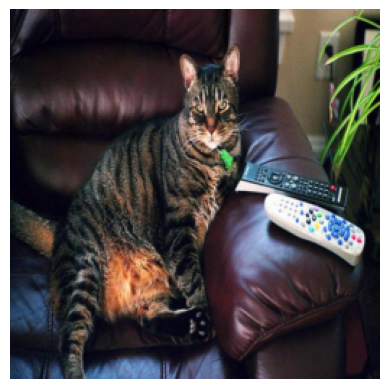

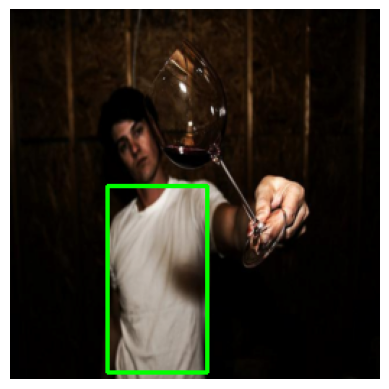

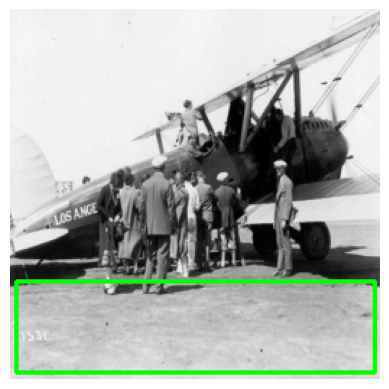

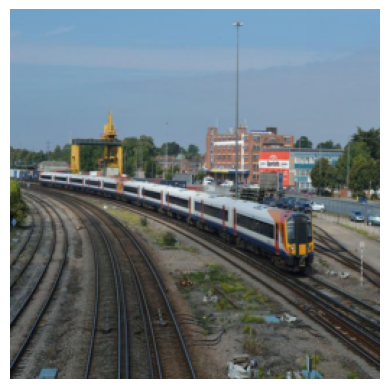

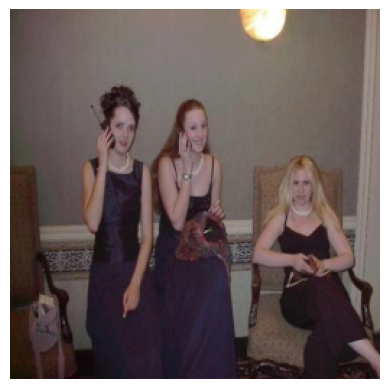

...

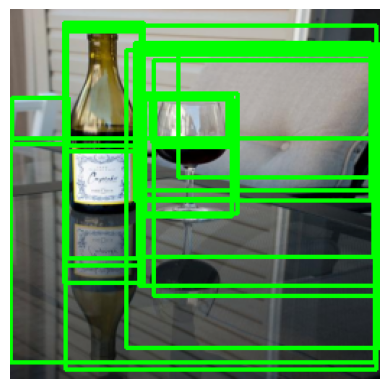

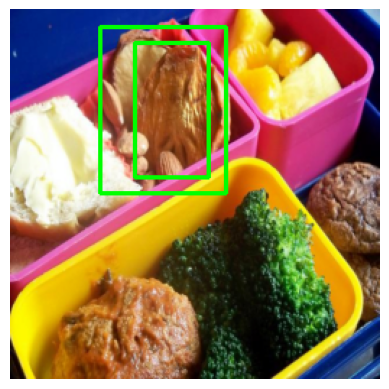

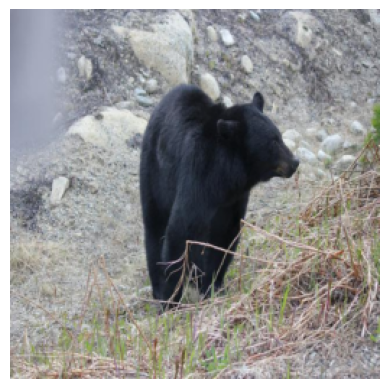

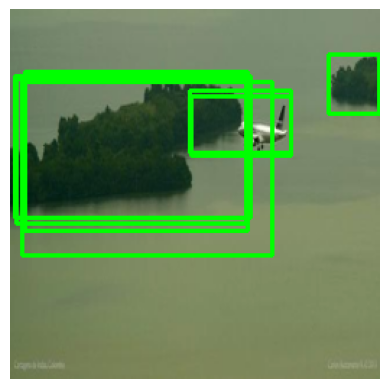

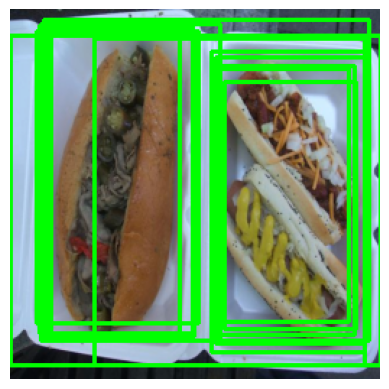

In [138]:
for images, targets_list in dataloader:  # Iteráció az adatbetöltőn
    images = list(image.to(device) for image in images)

    # Lista átalakítása az elvárt formátumba
    targets = []
    for target in targets_list:
        target_dict = {'boxes': [], 'labels': []}
        for label in target:
            if label:
                target_dict['boxes'].append(label[1:])  # Add bounding box coordinates
                target_dict['labels'].append(label[0])  # Add class ID
        # Listák tenzorokká alakítása
        target_dict['boxes'] = torch.tensor(target_dict['boxes']).to(device)
        target_dict['labels'] = torch.tensor(target_dict['labels']).to(device)
        targets.append(target_dict)

    with torch.no_grad():  # Inferencia futtatása mindegyik modellel 
        model = faster
        predictions = model(images)
        all_predictions[model.__class__.__name__].append((predictions, targets))
        
        for pred, image in zip(predictions, images):
            boxes = pred['boxes']
            labels = pred['labels']

            # Kép denormalizálása
            img = image.permute(1, 2, 0).cpu().numpy() * std + mean
            img = np.clip(img, 0, 1)

            # 0-255 tartományba konvertálás
            img = (img * 255).astype(np.uint8)
            img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)

            boxes = pred['boxes']
            labels = pred['labels']

            # Kereteződobozok felrajzolása
            for box, label in zip(boxes, labels):
                xmin, ymin, xmax, ymax = [int(b) for b in box]
                cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)

            # RGB formátumba alakítás 
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            # Kép kirajzolása
            plt.imshow(img_rgb)
            plt.axis('off')
            plt.show()